In [1]:
# ----------------- IMPORTS LIBRARIES -------------------------- #
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import normalize
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
import copy
import time
import seaborn as sns
from yellowbrick.cluster import KElbowVisualizer
from kmodes.kprototypes import KPrototypes
from sklearn.metrics import silhouette_score

In [2]:
# -------------------------- FUNCTIONS -------------------------- #

# FUNCTION TO RETURN THE DATASET FROM ITS URL
def getDataSet(df_path):
    df_found = pd.read_csv(df_path, encoding= 'unicode_escape')
    return df_found

def printResumeNanColumns(dataSet):
    print("No. of columns containing null values = " + str(len(df_usa_hospital_beds.columns[df_usa_hospital_beds.isna().any()])))

    for column in dataSet:
        if dataSet[column].isnull().any():
            print('  {0}, type = {1}'.format(column, dataSet[column].dtypes))

    totalOfRecords = dataSet["ID"].count()
    totalOfNanRecords = dataSet.isnull().sum().sum()

    print("Total of records = " + str(totalOfRecords))
    print("Total of NaN records = " + str(totalOfNanRecords))
    print("Percentual of NaN records = " + str( ( (totalOfNanRecords / totalOfRecords) * 100).astype(int).round()  )  )

def convertColumnsToFloatType(dataSet):
    for column in dataSet:
        dataSet[column] = dataSet[column].astype(float)
    return dataSet

def getKModel(dataSet, k, rs):
  return KMeans(n_clusters=k, random_state=rs).fit(dataSet)
  
  #labels = k_means.predict(dataSet)
  #xs = dataSet[:,0]
  #ys = dataSet[:,1]

  #return k_means

  # pairplot the cluster distribution.
  #cluster_g = sns.pairplot(df2, hue='Cluster_ID', diag_kind='hist')
  #plt.show()

  #plt.scatter(xs, ys, c=labels)
  #plt.show()

def printKModel(model, dataSet):
  y = model.predict(dataSet)
  dataSet['Cluster_ID'] = y

  # how many records are in each cluster
  print("Cluster membership")
  print(dataSet['Cluster_ID'].value_counts())

  # pairplot the cluster distribution.
  cluster_g = sns.pairplot(dataSet, hue='Cluster_ID', diag_kind='hist')
  plt.show()

def printKElbow(dataSet):
  # Instantiate a scikit-learn K-Means model
  model = KMeans(random_state=0)

  # Instantiate the KElbowVisualizer with the number of clusters and the metric 
  visualizer = KElbowVisualizer(model, k=(2,10), metric='silhouette', timings=False)

  # Fit the data and visualize
  visualizer.fit(dataSet)    
  visualizer.poof()  

def getStandardizedDataSet(dataSet):
  return MinMaxScaler().fit_transform(dataSet)

In [3]:
# FIRST AT ALL IT IS ASSIGNED IN A VARIABLE THE ADDRESS OF THE DATASET GIVEN
patient_Route_path = "PatientRoute.csv"

usa_hospital_beds_path = "usa_hospital_beds.csv"

# THE VARIABLE ASSIGNED ABOVE IS USED TO READ THE DATASET PRESENTED IN THE ASSESSIMENT.
#df_patient_Route = getDataSet(patient_Route_path)
df_usa_hospital_beds = getDataSet(usa_hospital_beds_path)

In [4]:
df_usa_hospital_beds.head()

,X,Y,ID,HOSPITAL_NAME,HOSPITAL_TYPE,ADDRESS,CITY,STATE,ZIP_CODE,COUNTY_NAME,STATE_NAME,NUM_LICENSED_BEDS,NUM_STAFFED_BEDS,NUM_ICU_BEDS,ADULT_ICU_BEDS,BED_UTILIZATION,Potential_Increase_In_Bed_Capac,AVG_VENTILATOR_USAGE
0,-112.066157,33.495498,1,Phoenix VA Health Care System (AKA Carl T Hayd...,VA Hospital,650 E Indian School Rd,Phoenix,AZ,85012,Maricopa,Arizona,62.0,62.0,0,0,NaN,0,0.0
1,-110.965885,32.181263,2,Southern Arizona VA Health Care System,VA Hospital,3601 S 6th Ave,Tucson,AZ,85723,Pima,Arizona,NaN,NaN,2,2,NaN,0,2.0
2,-119.779742,36.773323,3,VA Central California Health Care System,VA Hospital,2615 E Clinton Ave,Fresno,CA,93703,Fresno,California,NaN,NaN,2,2,NaN,0,2.0
3,-72.957610,41.284400,4,VA Connecticut Healthcare System - West Haven ...,VA Hospital,950 Campbell Ave,West Haven,CT,6516,New Haven,Connecticut,216.0,216.0,1,1,NaN,0,2.0
4,-75.606533,39.740206,5,Wilmington VA Medical Center,VA Hospital,1601 Kirkwood Hwy,Wilmington,DE,19805,New Castle,Delaware,NaN,NaN,0,0,NaN,0,1.0


### 1. Identify the data quality problems in this dataset such as unusual data types, missing values, etc, and explain how to fix them?

In [5]:
# BY AN INITIAL ANALYZE FROM THE THE COLUMNS IS FIGURED OUT THAT THE COLUMNS HOSPITAL_NAME, HOSPITAL_TYPE, ADDRESS, CITY, STATE, ZIP_CODE AND STATE_NAME ARE CARACTERIZED AS SUPERVISING LEARNING AND SO, THEY ARE NOT SUITABLE IN THIS PROJECT. WHAT MAKES THEM TO BE IGNORED. ABOVE IS SELECTED JUST THE COLUMNS TO BE USED IN THIS PROJECT. 
df_usa_hospital_beds = df_usa_hospital_beds[{'ID'
                                           , 'HOSPITAL_TYPE'
                                           , 'NUM_LICENSED_BEDS'
                                           , 'NUM_STAFFED_BEDS'
                                           , 'NUM_ICU_BEDS'
                                           , 'ADULT_ICU_BEDS'
                                           , 'BED_UTILIZATION'
                                           , 'Potential_Increase_In_Bed_Capac'
                                           , 'AVG_VENTILATOR_USAGE'}]

In [6]:
# AS SHOWN BELOW THERE ARE float, int64 AND object KINDS OF DATA IN THE DATASET GIVEN.
df_usa_hospital_beds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6626 entries, 0 to 6625
Data columns (total 9 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   ADULT_ICU_BEDS                   6626 non-null   int64  
 1   Potential_Increase_In_Bed_Capac  6626 non-null   int64  
 2   NUM_LICENSED_BEDS                6403 non-null   float64
 3   AVG_VENTILATOR_USAGE             6567 non-null   float64
 4   NUM_STAFFED_BEDS                 6328 non-null   float64
 5   BED_UTILIZATION                  5917 non-null   float64
 6   HOSPITAL_TYPE                    6626 non-null   object 
 7   NUM_ICU_BEDS                     6626 non-null   int64  
 8   ID                               6626 non-null   int64  
dtypes: float64(4), int64(4), object(1)
memory usage: 466.0+ KB


In [7]:
# TO KEEP A PATTERN AND ALSO BECAUSE MANY OF THE DATA-MINING ALGORITHMS WORK JUST WITH NUMERICAL DATA THE FIELD HOSPITAL_TYPE WHICH IS CATEGORIZED.
df_usa_hospital_beds['HOSPITAL_TYPE'] = pd.get_dummies(df_usa_hospital_beds['HOSPITAL_TYPE'],  drop_first=True)

In [8]:
# FROM AN INITIAL ANALIZE THE FIELDS NUM_ICU_BEDS, ADULT_ICU_BEDS
df_usa_hospital_beds[{'NUM_ICU_BEDS', 'ADULT_ICU_BEDS'}].head()

,NUM_ICU_BEDS,ADULT_ICU_BEDS
0,0,0
1,2,2
2,2,2
3,1,1
4,0,0


In [9]:
# AND ALSO AFTER THEIR VALUES BE subtractED IS CONCLUDED THAT THESE COLUMNS PRESENTS THE SAME VALUES
adult_icu_beds = df_usa_hospital_beds['ADULT_ICU_BEDS'].sum()
num_icu_beds = df_usa_hospital_beds['NUM_ICU_BEDS'].sum()

print(adult_icu_beds - num_icu_beds)

0


In [10]:
# AND SO THE FIELD ADULT_ICU_BEDS IS EXCLUDED FROM THE DATASET
df_usa_hospital_beds.drop(columns=['ADULT_ICU_BEDS'], inplace=True)

In [11]:
# AN SIMILAR ANALYZE IN THE FIELDS NUM_LICENSED_BEDS AND NUM_STAFFED_BEDS WAS MADE. AND AS THEY PRESENTS DIFERENT VALUES THEY ARE KEEPED IN THE DATASET
potential = df_usa_hospital_beds['NUM_LICENSED_BEDS'].sum() - df_usa_hospital_beds['NUM_STAFFED_BEDS'].sum()
potential

140317.0

In [12]:
# AS A LAST ANALYZE THE COLUMN Potential_Increase_In_Bed_Capac WAS CHECKED WHETHER IT HAS BEEN PROPER CALCULATED ACCORDING TO THE PROJECT ANNOUNCEMENT AND CONCLUED THAT IS PROPER CALCULATED. AND SO THIS COLUMNS DOES NOT SUFFER ANY CHANGE.
the_same = (potential == df_usa_hospital_beds['Potential_Increase_In_Bed_Capac'].sum())
the_same

True

In [13]:
# NEXT STEP WAS TO PROT A GRAPH WITH THE NaN VALUES.
printResumeNanColumns(df_usa_hospital_beds)

No. of columns containing null values = 4
  NUM_LICENSED_BEDS, type = float64
  AVG_VENTILATOR_USAGE, type = float64
  NUM_STAFFED_BEDS, type = float64
  BED_UTILIZATION, type = float64
Total of records = 6626
Total of NaN records = 1289
Percentual of NaN records = 19


In [14]:
# AS SHOWN ABOVE THE DATASET GIVEN PRESENTS A TOTAL OF 1289 NULL DATA FROM FOUR DIFERENT COLUMNS. THIS NUMBER REPRESENTS 19% OF THE TOTAL RECORDS
#df_usa_hospital_beds['NUM_LICENSED_BEDS'][df_usa_hospital_beds['NUM_LICENSED_BEDS'].isnull()] = 0
#df_usa_hospital_beds['NUM_STAFFED_BEDS'][df_usa_hospital_beds['NUM_STAFFED_BEDS'].isnull()] = 0
#df_usa_hospital_beds['BED_UTILIZATION'][df_usa_hospital_beds['BED_UTILIZATION'].isnull()] = 0
#df_usa_hospital_beds['AVG_VENTILATOR_USAGE'][df_usa_hospital_beds['AVG_VENTILATOR_USAGE'].isnull()] = 0

df_usa_hospital_beds = df_usa_hospital_beds.dropna(axis=0)
df_usa_hospital_beds = convertColumnsToFloatType(df_usa_hospital_beds)

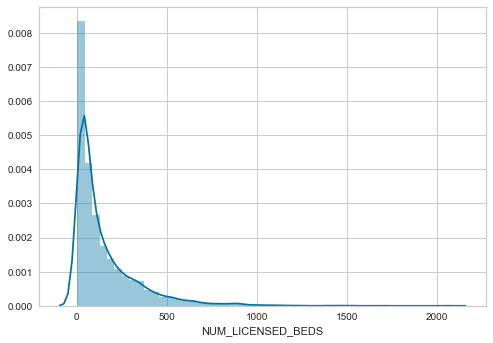

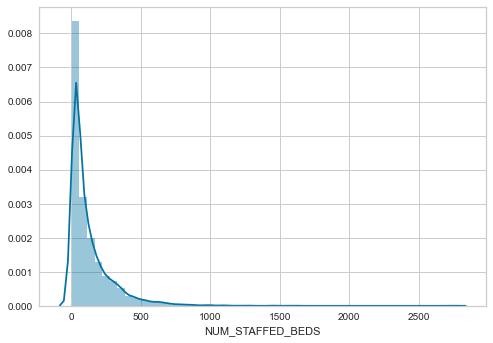

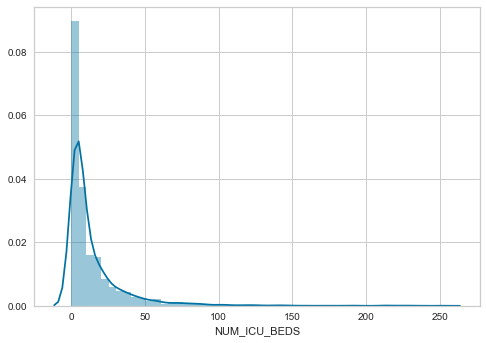

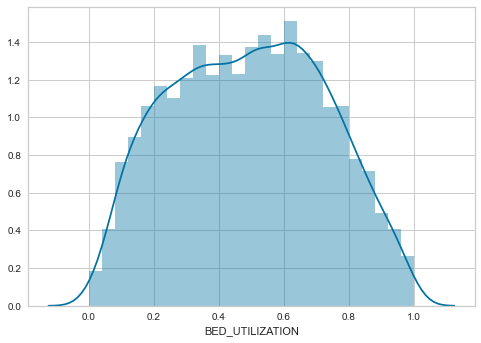

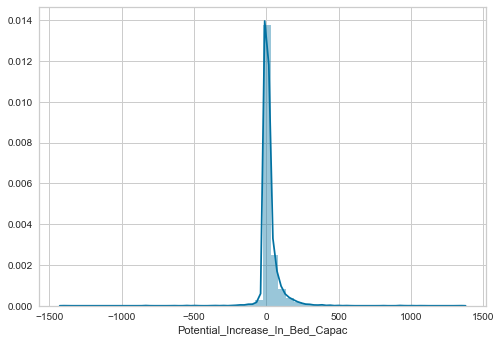

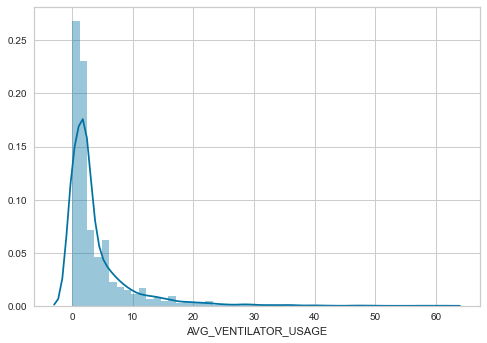

In [15]:
# Distribution of RegDens
sns.distplot(df_usa_hospital_beds['NUM_LICENSED_BEDS'])
plt.show()

sns.distplot(df_usa_hospital_beds['NUM_STAFFED_BEDS'])
plt.show()

sns.distplot(df_usa_hospital_beds['NUM_ICU_BEDS'])
plt.show()

sns.distplot(df_usa_hospital_beds['BED_UTILIZATION'])
plt.show()

sns.distplot(df_usa_hospital_beds['Potential_Increase_In_Bed_Capac'])
plt.show()

sns.distplot(df_usa_hospital_beds['AVG_VENTILATOR_USAGE'])
plt.show()

### 2. Build a clustering model to profile the hospitals based on the beds and ventilators'capacity. Answer the followings:

In [16]:
df_clustering = df_usa_hospital_beds[['NUM_LICENSED_BEDS', 'Potential_Increase_In_Bed_Capac', 'AVG_VENTILATOR_USAGE']]

# convert df2 to matrix
X = df_clustering.to_numpy()

# scaling
X = StandardScaler().fit_transform(X)
model = KMeans(n_clusters=3, random_state=42).fit(X)

# sum of intra-cluster distances
print("Sum of intra-cluster distance:", model.inertia_)

#print("Centroid locations:")
for centroid in model.cluster_centers_:
    print(centroid)

Sum of intra-cluster distance: 7903.433830658487
[-0.44904073 -0.24022481 -0.39105287]
[2.97965618 1.67902072 3.01291583]
[0.90290894 0.46194484 0.68257938]


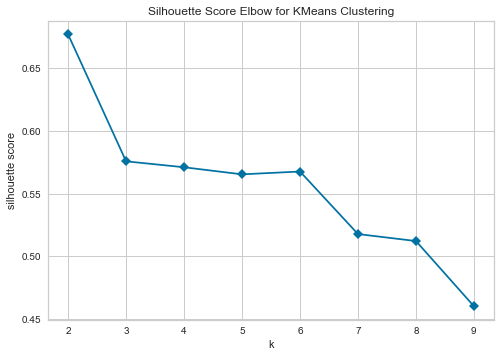

In [17]:
printKElbow(X)

In [18]:
modelK3 = KMeans(n_clusters=3, random_state=42, n_jobs=10).fit(X)
print(modelK3)
print("Silhouette score for k=3", silhouette_score(X, modelK3.predict(X)))

print("")

modelK4 = KMeans(n_clusters=4, random_state=42, n_jobs=10).fit(X)
print(modelK4)
print("Silhouette score for k=4", silhouette_score(X, modelK4.predict(X)))

KMeans(n_clusters=3, n_jobs=10, random_state=42)
Silhouette score for k=3 0.5756395190627982

KMeans(n_clusters=4, n_jobs=10, random_state=42)
Silhouette score for k=4 0.57071935563481


Cluster membership
0    4407
2    1205
1     299
Name: Cluster_ID, dtype: int64


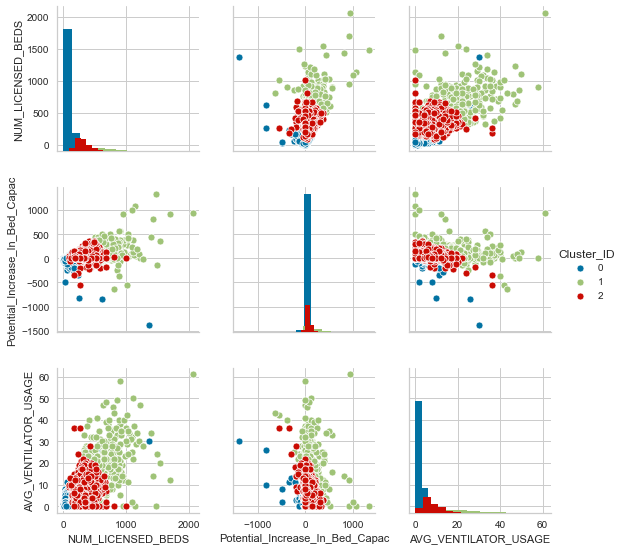

In [19]:
# scaling
y = model.fit_predict(X) 

df_clustering['Cluster_ID'] = y

# how many records are in each cluster
print("Cluster membership")
print(df_clustering['Cluster_ID'].value_counts())

# pairplot the cluster distribution.
cluster_g = sns.pairplot(df_clustering, hue='Cluster_ID', diag_kind='hist')
plt.show()

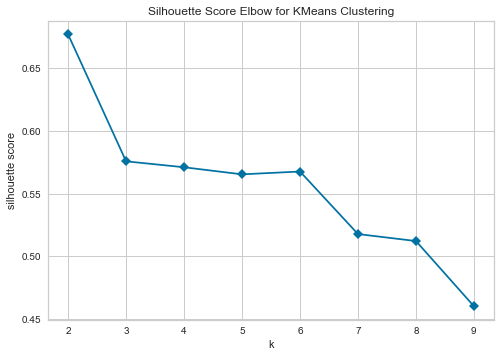

In [20]:
# scaling
model = AgglomerativeClustering(n_clusters=5).fit(X)

printKElbow(X)

Cluster membership
3    4377
2    1151
1     227
0     145
4      11
Name: Cluster_ID, dtype: int64


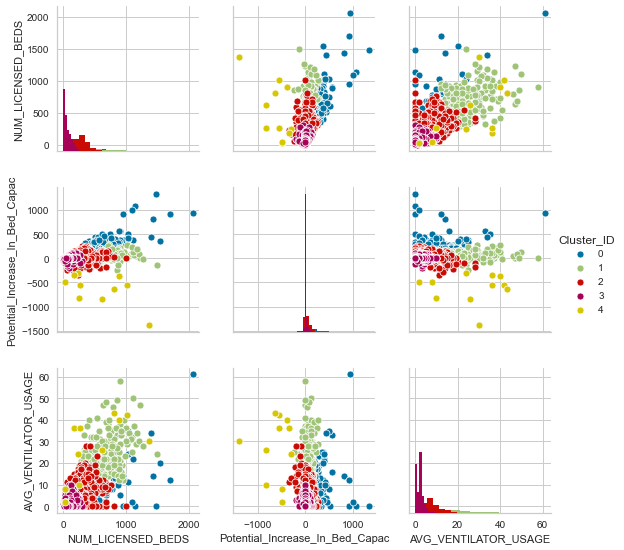

In [21]:
y = model.fit_predict(X) 

df_clustering['Cluster_ID'] = y

# how many records are in each cluster
print("Cluster membership")
print(df_clustering['Cluster_ID'].value_counts())

# pairplot the cluster distribution.
cluster_g = sns.pairplot(df_clustering, hue='Cluster_ID', diag_kind='hist')
plt.show()

BELLOW IS THE DATA NORMALIZATION

In [22]:
df_clustering = df_usa_hospital_beds[['NUM_LICENSED_BEDS', 'Potential_Increase_In_Bed_Capac', 'AVG_VENTILATOR_USAGE']]

X = MinMaxScaler().fit_transform(df_clustering)

model = KMeans(n_clusters=3, random_state=42).fit(X)

# sum of intra-cluster distances
print("Sum of intra-cluster distance:", model.inertia_)

#print("Centroid locations:")
for centroid in model.cluster_centers_:
    print(centroid)

Sum of intra-cluster distance: 27.933693551678655
[0.03248621 0.51185223 0.02665697]
[0.33194313 0.53965015 0.37446074]
[0.15876212 0.53085755 0.12637064]


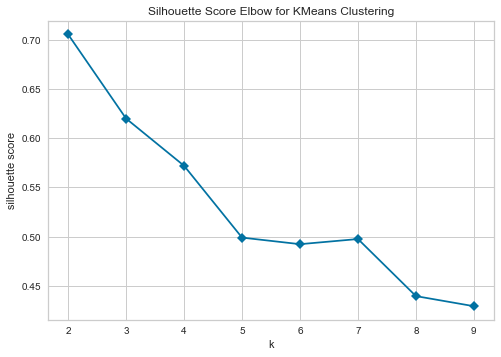

In [23]:
printKElbow(X)

Cluster membership
0    3623
4    1269
2     685
3     254
1      80
Name: Cluster_ID, dtype: int64


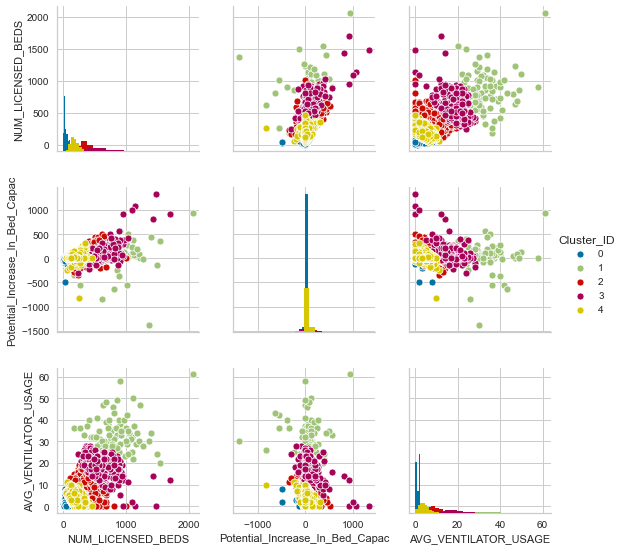

In [24]:
model = KMeans(n_clusters=5, random_state=42).fit(X)
y = model.fit_predict(X)

df_clustering['Cluster_ID'] = y

# how many records are in each cluster
print("Cluster membership")
print(df_clustering['Cluster_ID'].value_counts())

# pairplot the cluster distribution.
cluster_g = sns.pairplot(df_clustering, hue='Cluster_ID', diag_kind='hist')
plt.show()

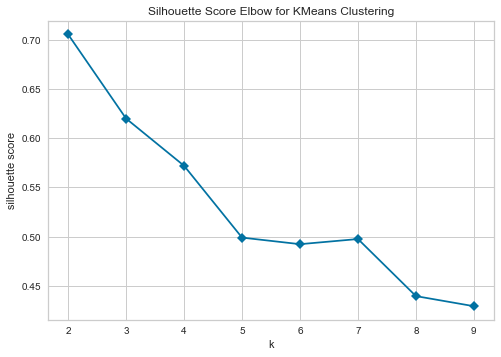

In [25]:
# scaling
model = AgglomerativeClustering(n_clusters=5).fit(X)

printKElbow(X)

Cluster membership
3    3146
4    1281
2     933
0     420
1     131
Name: Cluster_ID, dtype: int64


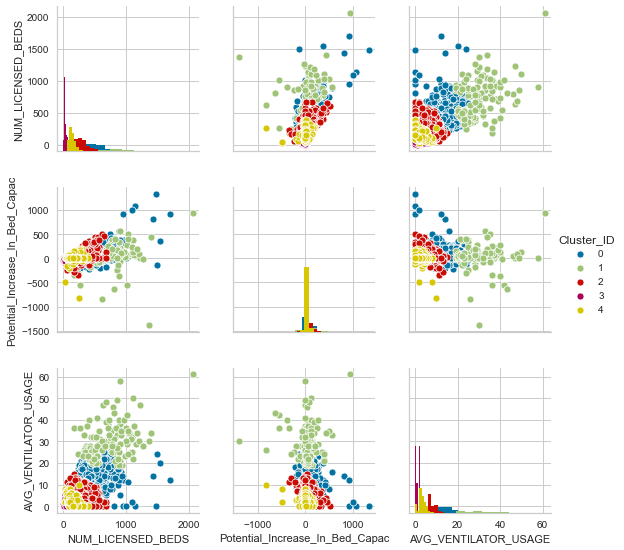

In [26]:
y = model.fit_predict(X) 

df_clustering['Cluster_ID'] = y

# how many records are in each cluster
print("Cluster membership")
print(df_clustering['Cluster_ID'].value_counts())

# pairplot the cluster distribution.
cluster_g = sns.pairplot(df_clustering, hue='Cluster_ID', diag_kind='hist')
plt.show()

### 3. For the model with the optimal number of clusters, 

[4 3 4 ... 2 3 3]


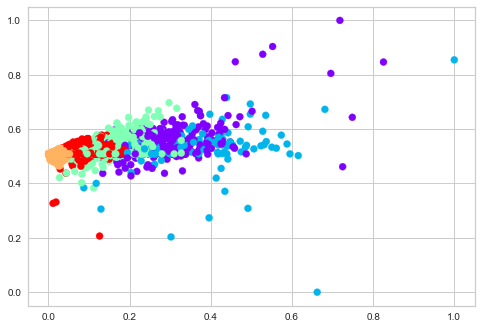

In [27]:
print(model.labels_)
plt.scatter(X[:,0],X[:,1], c=model.labels_, cmap='rainbow')